<a href="https://colab.research.google.com/github/hariseldon99/msph402b/blob/main/Special_Topics_Pt1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

### Special Topics - Part 1

Solving Laplace Equation using the Jacobi Update
=================================================
Consider a wire of length $N$ kept at a constant voltage of $V=100$. Divide the two-dimensional space into a grid of size $N\times N$, with the wire running horizontally at the beginning of the grid. Then, solve Laplace's equation numerically using the Finite Difference Method with Jacobi updates, assuming that the potential is grounded at all the other edges. Laplace's equation is
\begin{equation*}
\frac{\partial^2u}{\partial x^2} + \frac{\partial^2u}{\partial y^2} = 0.
\end{equation*}

Running the Jacobi Update Solver ...


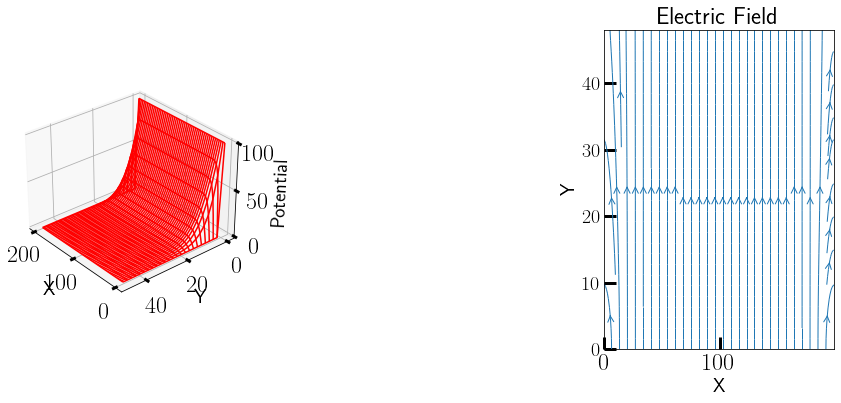

In [ ]:
%matplotlib inline
import numpy as np
import matplotlib.pyplot as plt

plt.rcParams['figure.figsize'] = (12,6)
plt.rcParams['font.size'] = 20


Nmax = 200
V_wire = 100

V = np.zeros((Nmax, Nmax))   
V[:,0] = V_wire                                     # Line at V_wire volts

print ("Running the Jacobi Update Solver ...")

def jacobi_update(V, Niter=70):
    Nmax = V.shape[0]
    for iter in range(Niter):
        for i in range(1, Nmax-2):                                                
            for j in range(1,Nmax-2): 
                V[i,j] = 0.25*(V[i+1,j]+V[i-1,j]+V[i,j+1]+V[i,j-1])  
    return V

V = jacobi_update(V)

x = np.arange(0, Nmax-1, 2);  y = np.arange(0, 50, 2)                              
X, Y = np.meshgrid(x,y)                 

def functz(V):                                         # V(x, y) 
    z = V[X,Y]                        
    return z

Z = functz(V)    

fig = plt.figure()

ax = fig.add_subplot(131,projection='3d')
ax.plot_wireframe(X, Y, Z, color = 'r')               # Red wireframe
ax.set_xlabel('X')                                     
ax.set_ylabel('Y')
ax.set_zlabel('Potential')
ax.view_init(30, 140) #Perspective

Eym, Exm = np.gradient(Z)

ax2 = fig.add_subplot(133)
ax2.set_title("Electric Field")
ax2.streamplot(X, Y, -Exm, -Eym, linewidth=1, density=1, arrowstyle='->', arrowsize=1.5)
ax2.set_xlabel('X')                                     
ax2.set_ylabel('Y')
plt.show()                                              # Show fig

Now, let us consider two plates inside a grounded box. The top plate is kept at $V=100\;V$ and the bottom at $V=-100\;V$. The two plates constitute a capacitor connected to a battery. Obtain the potential and electric field as a function of space and plot them. 

Running the Jacobi Update Solver ...


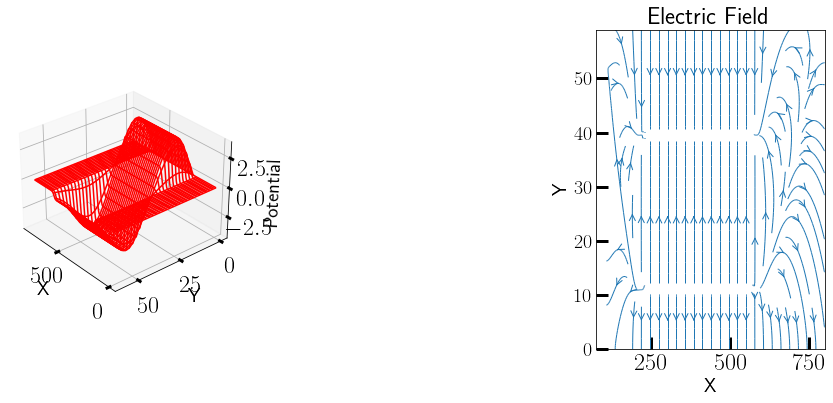

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

plt.rcParams['figure.figsize'] = (12,6)
plt.rcParams['font.size'] = 20


Nmax = 800
V_wire = 100
V = np.zeros((Nmax, Nmax))   

x_start = 200
y_start = 10
separation = 30

V[x_start:Nmax-x_start,y_start] = V_wire                                     # Line at V_wire volts
V[x_start:Nmax-x_start,y_start+separation] = -V_wire                                     # Line at V_wire volts

print ("Running the Jacobi Update Solver ...")

def jacobi_update(V, Niter=90):
    Nmax = V.shape[0]
    for iter in range(Niter):
        for i in range(1, Nmax-2):                                                
            for j in range(1,Nmax-2): 
                V[i,j] = 0.25*(V[i+1,j]+V[i-1,j]+V[i,j+1]+V[i,j-1])  
    return V

V = jacobi_update(V)

offset = 20
x = np.arange(0, Nmax-1, 1);  y = np.arange(0, y_start+separation+offset, 1)                              
X, Y = np.meshgrid(x,y)                 

def functz(V):                                         # V(x, y) 
    z = V[X,Y]                        
    return z

Z = functz(V)    

fig = plt.figure()

ax = fig.add_subplot(131,projection='3d')
ax.plot_wireframe(X, Y, Z, color = 'r')               # Red wireframe
ax.set_xlabel('X')                                     
ax.set_ylabel('Y')
ax.set_zlabel('Potential')
ax.view_init(30, 140) #Perspective

Eym, Exm = np.gradient(Z)

ax2 = fig.add_subplot(133)
ax2.set_title("Electric Field")
ax2.streamplot(X, Y, -Exm, -Eym, linewidth=1, density=1, arrowstyle='->', arrowsize=1.5)
ax2.set_xlabel('X')                                     
ax2.set_ylabel('Y')
plt.show()                                              # Show fig

### Wave equation and the Leapfrog method

Obtain numerical solutions for the $1d$ wave equation for a plucked string. The wave equation is

\begin{equation*}
\frac{\partial^2y}{\partial x^2} + \frac{1}{c^2}\frac{\partial^2y}{\partial t^2} = 0,
\end{equation*}

subject to boundary conditions
\begin{align*}
\left.y\right\vert_{t=0} &= \mbox{ given }\\
\left.\frac{\partial y}{\partial t}\right\vert_{t=0} &=0
\end{align*}

Use the leapfrog method for time stepping as discussed in the lectures. Try the first boundary condition, where the string is plucked to $y=1$ at $80\%$ of the end point, and the string is fixed at edges at all times $y(x=0,N)=0$, where $N$ is the number of grid points chosen along $x$. Make suitable modifications to the initial condition such that the string is now plucked exactly midway between the end points.

Done! Now Building Animation ...


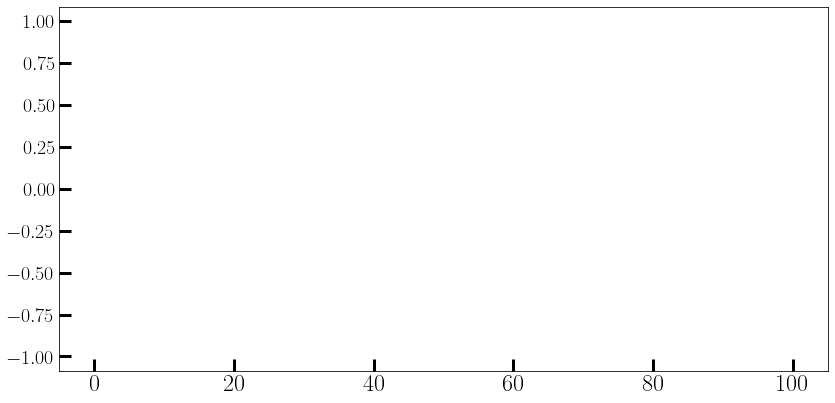

In [ ]:
%matplotlib inline
from IPython.display import HTML
import numpy as np
import matplotlib.pyplot as plt
from celluloid import Camera

plt.rcParams['figure.figsize'] = (12,6)
plt.rcParams['font.size'] = 20
plt.rcParams['font.size'] = 20
plt.rcParams['animation.embed_limit'] = 50

# Parameters
cc1 = 0.9
ratio =  cc1**2
N = 100
tmax = 2000

# Initialization
xi = np.zeros((N+1,3))

# For 80% plucking
#risept = int(0.8 * N)
#riseind = np.arange(risept+1)
#xi[riseind, 0 ] =   1.25 * riseind/N
#fallind = np.arange(risept+1,N+1)
#xi[fallind, 0 ] =  5. * (1- (fallind/N))

# For 50% plucking
risept = int(0.5 *N)
riseind = np.arange(risept+1)
xi[riseind, 0 ] =  2.0 *  riseind/N
fallind = np.arange(risept,N+1)
xi[fallind, 0 ] =  2.0 * (1 - fallind/N)

fig = plt.figure()
camera = Camera(fig)

# Later time steps
for i in range(1, N): 
    xi[i,1] = xi[i,0] + 0.5*ratio*(xi[i+1,0]+xi[i-1,0]-2*xi[i,0])

for t in range(tmax):                               
    for i in range(1, N):              
        xi[i,2] = 2.*xi[i,1] - xi[i,0] + ratio * (xi[i+1,1]+xi[i-1,1]-2*xi[i, 1])

    xi[:,0] = xi[:, 1]
    xi[:,1] = xi[:, 2]
    f = plt.plot(np.arange(N+1),xi[:,1],'b')
    camera.snap()
    
print("Done! Now Building Animation ...")
anim = camera.animate(blit=False, interval=30)
HTML(anim.to_jshtml(default_mode="once"))


The Numerov Algorithm in Python
=====================================

Use the Numerov Algorithm to obtain the eigenstates of the Harmonic Oscillator. The Hamiltonian is

\begin{equation*}
H = \frac{p^2}{2} + x^2
\end{equation*}

Analytically, the eigenvalues are given by $E_n = 2n+1$. What happens if you add a perturbation $H\rightarrow H + \alpha x^4$ to the Hamiltonian?

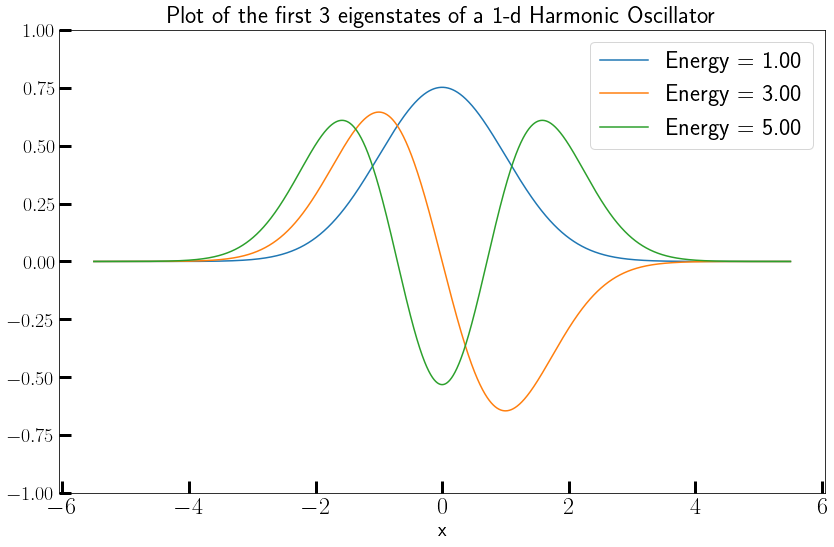

In [ ]:
import numpy as np
from scipy.integrate import simps
import matplotlib.pyplot as plt

plt.rcParams['figure.figsize'] = (12,8)
plt.rcParams['font.size'] = 20

def numerov_schrodinger_1d(x0, Vx0, E, dpsi=1e-5):
    '''
    Numerov algorithm

            2 * [1 - 5 * h1^2 * k^2(n)] * y(n) - [1 + h1^2 * k^2(n-1)] * y(n-1)
  y(n+1) = ------------------------------------------------------------------
                                    [1 + h1^2 * k^2(n+1)]

    where

        h1 = h^2_0/12

        k(n) = E - Vx0(x0(n))
    '''

    psi = np.zeros(x0.size)

    psi[0] = 0.0
    psi[1] = dpsi

    h0 = x0[1] - x0[0]

    ksq = E - Vx0

    h12 = h0**2 / 12.

    for ii in range(2, x0.size):
        psi[ii] = 2 * (1 - 5 * h12 * ksq[ii-1]) * psi[ii-1] - \
                    (1 + h12 * ksq[ii-2]) * psi[ii-2]
        psi[ii] /= 1 + h12 * ksq[ii]

    # Normalization by Simpson's Method
    psi /= np.sqrt(simps(psi**2, x=x0))
    return psi


# Harmonic Oscillator V(x) = x^2 with pert
a = 0.0
x = np.linspace(-5.5, 5.5, 3000)
Vx = x**2 + a * x**4
neigen = 3
energies = 2 * np.arange(neigen) +1

for e in energies:
    plt.plot(x, numerov_schrodinger_1d(x, Vx, e),
             label=f"Energy = {e:1.2f}")

plt.title(f"Plot of the first {len(energies)} eigenstates\
                        of a 1-d Harmonic Oscillator")
plt.legend()
plt.xlabel('x')

plt.ylim(-1.0, 1.0)
plt.show()

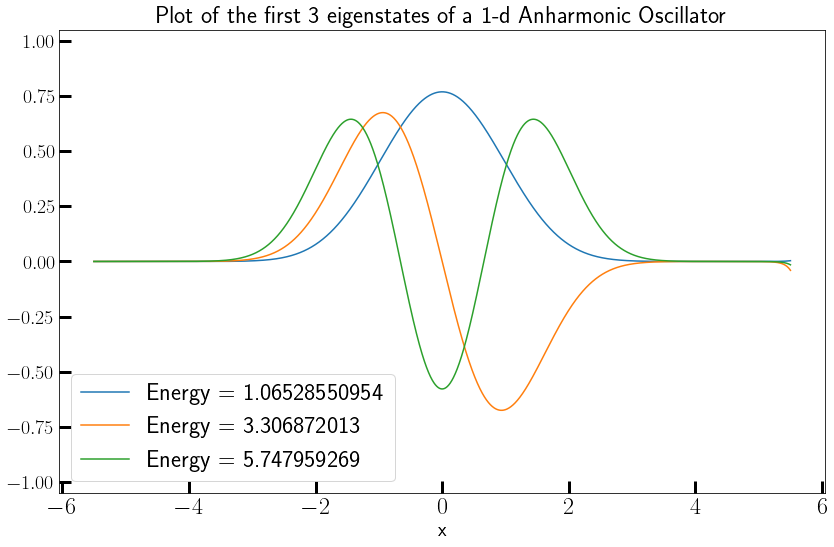

In [ ]:
import numpy as np
from scipy.integrate import simps
import matplotlib.pyplot as plt

plt.rcParams['figure.figsize'] = (12,8)
plt.rcParams['font.size'] = 20

# Harmonic Oscillator V(x) = x^2 with pert
a = 0.1
x = np.linspace(-5.5, 5.5, 3000)
Vx = x**2 + a * x**4

#energies = [1.06]
#energies = [1.07]
energies = [1.06528550954, 3.30687201300, 5.747959269]

for e in energies:
    plt.plot(x, numerov_schrodinger_1d(x, Vx, e),
             label=f"Energy = {e}")

plt.title(f"Plot of the first {len(energies)} eigenstates\
                        of a 1-d Anharmonic Oscillator")
plt.legend()
plt.xlabel('x')

plt.ylim(-1.05, 1.05)
plt.show()

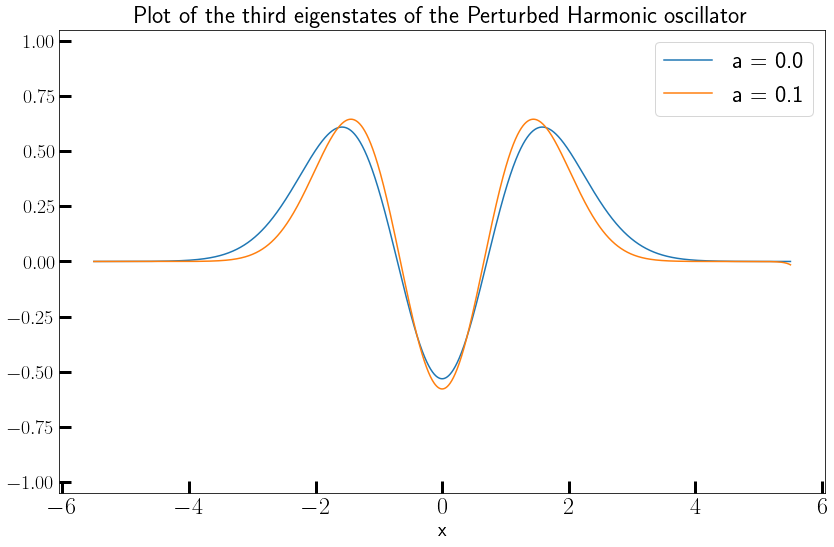

In [ ]:
import numpy as np
from scipy.integrate import simps
import matplotlib.pyplot as plt

plt.rcParams['figure.figsize'] = (12,8)
plt.rcParams['font.size'] = 20

# Harmonic Oscillator V(x) = x^2 with pert
avals = [0.0, 0.1]
evals = [5.0, 5.747959269]
x = np.linspace(-5.5, 5.5, 3000)

for i,a in enumerate(avals):
    plt.plot(x, numerov_schrodinger_1d(x, x**2 + a * x**4, evals[i]),
             label=f"a = {a}")

plt.title(f"Plot of the third eigenstates of the Perturbed Harmonic oscillator")
plt.legend()
plt.xlabel('x')

plt.ylim(-1.05, 1.05)
plt.show()